In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import matplotlib

from sklearn.datasets import load_digits
from sklearn.datasets import fetch_openml
import sklearn.datasets as dt
import scipy

from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors
from scipy.spatial.distance import pdist
from sklearn.utils import resample
from tensorflow.keras.datasets.fashion_mnist import load_data
from umap import UMAP

#Import all the algorithms
from umap import UMAP
import openTSNE
from openTSNE import TSNE as OpenTSNE
from openTSNE import affinity, initialization, TSNEEmbedding
from MulticoreTSNE import MulticoreTSNE

import time
%matplotlib inline

In [4]:
def sns_styleset():
    sns.set_context('paper')
    sns.set_style('ticks')
    matplotlib.rcParams['axes.linewidth']    = .75
    matplotlib.rcParams['xtick.major.width'] = .75
    matplotlib.rcParams['ytick.major.width'] = .75
    matplotlib.rcParams['xtick.major.size'] = 3
    matplotlib.rcParams['ytick.major.size'] = 3
    matplotlib.rcParams['xtick.minor.size'] = 2
    matplotlib.rcParams['ytick.minor.size'] = 2
    matplotlib.rcParams['font.size']       = 7
    matplotlib.rcParams['axes.titlesize']  = 7
    matplotlib.rcParams['axes.labelsize']  = 7
    matplotlib.rcParams['legend.fontsize'] = 7
    matplotlib.rcParams['xtick.labelsize'] = 7
    matplotlib.rcParams['ytick.labelsize'] = 7
sns_styleset()

In [5]:
#Simulation data
nn = [2000, 2000, 2000, 2000, 2000,  1000, 1000, 1000, 1000, 1000,  100, 100, 100, 100, 100]
d1 = [4,   4,   4,   4,   4,    10,  10,  10,  10,  10,   10,  10,  10,  10,  10]
d2 = [20,  20,  20,  20,  20,   20,  20,  20,  20,  20,   20,  20,  20,  20,  20]
cl = [0,   0,   0,   0,   0,    1,   1,   1,   1,   1,    2,   2,   2,   2,   2]

p = 50   # dimensionality

np.random.seed(42)
X = []
y = []

for i,n in enumerate(nn):
    Xpart = np.random.randn(n,p)
    Xpart[:, i] += d1[i]
    Xpart[:,20+cl[i]] += d2[i]
    X.append(Xpart)
    
    ypart = np.ones(n) * i
    y.append(ypart)
          
X = np.concatenate(X)
y = np.concatenate(y)

In [6]:
np.unique(y)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14.])

In [4]:
def embedding_quality(X, Z, classes, knn=10, knn_classes=10, subsetsize=1000):
    nbrs1 = NearestNeighbors(n_neighbors=knn).fit(X)
    ind1 = nbrs1.kneighbors(return_distance=False)

    nbrs2 = NearestNeighbors(n_neighbors=knn).fit(Z)
    ind2 = nbrs2.kneighbors(return_distance=False)

    intersections = 0.0
    for i in range(X.shape[0]):
        intersections += len(set(ind1[i]) & set(ind2[i]))
    mnn = intersections / X.shape[0] / knn
    
    cl, cl_inv = np.unique(classes, return_inverse=True)
    C = cl.size
    mu1 = np.zeros((C, X.shape[1]))
    mu2 = np.zeros((C, Z.shape[1]))
    for c in range(C):
        mu1[c,:] = np.mean(X[cl_inv==c,:], axis=0)
        mu2[c,:] = np.mean(Z[cl_inv==c,:], axis=0)
        
    nbrs1 = NearestNeighbors(n_neighbors=knn_classes).fit(mu1)
    ind1 = nbrs1.kneighbors(return_distance=False)
    nbrs2 = NearestNeighbors(n_neighbors=knn_classes).fit(mu2)
    ind2 = nbrs2.kneighbors(return_distance=False)
    
    intersections = 0.0
    for i in range(C):
        intersections += len(set(ind1[i]) & set(ind2[i]))
    mnn_global = intersections / C / knn_classes
    
    subset = np.random.choice(X.shape[0], size=subsetsize, replace=False)
    d1 = pdist(X[subset,:])
    d2 = pdist(Z[subset,:])
    rho = scipy.stats.spearmanr(d1[:,None],d2[:,None]).correlation
    
    return (mnn, mnn_global, rho)

    

In [25]:
embed =[]
%time embed.append(PCA(n_components=2).fit_transform(X))
%time embed.append(OpenTSNE(n_jobs=-1, random_state=42, initialization='random').fit(X))
%time embed.append(OpenTSNE(n_jobs=-1, random_state=42).fit(X))
%time embed.append(OpenTSNE(n_jobs=-1, random_state=42, learning_rate=n/12).fit(X))
#Multi-Scale kernel
%time affinities_multiscale_mix = affinity.Multiscale(X, perplexities=[30, int(X.shape[0]/100)], n_jobs=-1, random_state=42)
%time pca_init = initialization.pca(X, random_state=42)
%time embedding0 = TSNEEmbedding(pca_init,affinities_multiscale_mix,negative_gradient_method="fft",n_jobs=8)
%time embedding1 = embedding0.optimize(n_iter=250, exaggeration=12, momentum=0.5)
%time embed.append(embedding1.optimize(n_iter=750, exaggeration=1, momentum=0.5))
#Learning Rate adjusted
%time affinities_multiscale_mix = affinity.Multiscale(X, perplexities=[30, int(X.shape[0]/100)], n_jobs=-1, random_state=42)
%time pca_init = initialization.pca(X, random_state=42)
%time embedding0 = TSNEEmbedding(pca_init,affinities_multiscale_mix,n/12,negative_gradient_method="fft",n_jobs=8)
%time embedding1 = embedding0.optimize(n_iter=250, exaggeration=12, momentum=0.5)
%time embed.append(embedding1.optimize(n_iter=750, exaggeration=1, momentum=0.5))
# %time embed.append(OpenTSNE(n_jobs=-1, random_state=42, learning_rate=n/12, perplexity=n/100).fit(X))
%time embed.append(UMAP(random_state=42, init='random').fit_transform(X))
%time embed.append(UMAP().fit_transform(X))

CPU times: user 392 ms, sys: 170 ms, total: 562 ms
Wall time: 43.9 ms
CPU times: user 34.6 s, sys: 2.26 s, total: 36.9 s
Wall time: 28.4 s
CPU times: user 34.5 s, sys: 2.19 s, total: 36.7 s
Wall time: 28.1 s
CPU times: user 30.7 s, sys: 1.54 s, total: 32.2 s
Wall time: 23 s
CPU times: user 32.8 s, sys: 556 ms, total: 33.3 s
Wall time: 7.56 s
CPU times: user 242 ms, sys: 313 ms, total: 555 ms
Wall time: 56.8 ms
CPU times: user 81 µs, sys: 372 µs, total: 453 µs
Wall time: 46 µs
CPU times: user 20.6 s, sys: 792 ms, total: 21.4 s
Wall time: 20.2 s
CPU times: user 1min 2s, sys: 1.39 s, total: 1min 3s
Wall time: 1min 3s
CPU times: user 32.6 s, sys: 549 ms, total: 33.1 s
Wall time: 7.57 s
CPU times: user 457 ms, sys: 107 ms, total: 564 ms
Wall time: 42.4 ms
CPU times: user 444 µs, sys: 76 µs, total: 520 µs
Wall time: 39.1 µs
CPU times: user 21 s, sys: 634 ms, total: 21.6 s
Wall time: 20.3 s
CPU times: user 1min, sys: 619 ms, total: 1min
Wall time: 1min
CPU times: user 12 s, sys: 185 ms, total

In [1]:
%%time
metrics = []
for Z in embed:
    knn, knc, cpd = embedding_quality(X, Z, y, knn=10, knn_classes=4, subsetsize=1000)
    metrics.append((knn, knc, cpd))

NameError: name 'embed' is not defined

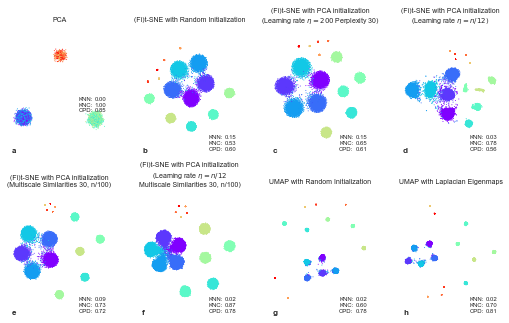

In [30]:
titles = ["PCA", "(Fi)t-SNE with Random Initialization", "(Fi)t-SNE with PCA initialization\n(Learning rate $\eta=200$ Perplexity 30)", "(Fi)t-SNE with PCA initialization\n(Learning rate $\eta=n/12$)", "(Fi)t-SNE with PCA initialization\n(Multiscale Similarities 30, n/100)", "(Fi)t-SNE with PCA initialization\n(Learning rate $\eta=n/12$\nMultiscale Similarities 30, n/100)", "UMAP with Random Initialization", "UMAP with Laplacian Eigenmaps"]

letters = 'abcdefgh'

plt.figure(figsize=(7.2, 4.5))

dy = [0.3,0,0,0,0,0,0,0]
for i,Z in enumerate(embed):
    plt.subplot(2,4,1+i)
    plt.gca().set_aspect('equal', adjustable='datalim')
    rand_order = np.random.permutation(Z.shape[0])
    plt.scatter(Z[rand_order,0], Z[rand_order,1], s=1, c=y[rand_order], cmap='rainbow', 
                rasterized=True, edgecolor='none')
    plt.title(titles[i], va='center')
    plt.text(0.70,.02+dy[i],'KNN:\nKNC:\nCPD:', transform=plt.gca().transAxes, fontsize=6)
    plt.text(0.87,.02+dy[i],'{:.2f}\n{:.2f}\n{:.2f}'.format(
        metrics[i][0], metrics[i][1], metrics[i][2]), transform=plt.gca().transAxes, fontsize=6)
    plt.text(0, 0, letters[i], transform = plt.gca().transAxes, fontsize=8, fontweight='bold')
    plt.xticks([])
    plt.yticks([])
    
sns.despine(left=True, bottom=True)
plt.tight_layout()
plt.savefig('simulation/toy-simulation.png', dpi=150)

In [17]:
#Multi-Scale kernel
%time affinities_multiscale_mix = affinity.Multiscale(X, perplexities=[30, int(X.shape[0]/100)], n_jobs=-1, random_state=42)
%time pca_init = initialization.pca(X, random_state=42)
%time embedding0 = TSNEEmbedding(pca_init,affinities_multiscale_mix,negative_gradient_method="fft",n_jobs=8)
%time embedding1 = embedding0.optimize(n_iter=250, exaggeration=12, momentum=0.5)

CPU times: user 33.9 s, sys: 625 ms, total: 34.5 s
Wall time: 7.92 s
CPU times: user 364 ms, sys: 197 ms, total: 562 ms
Wall time: 47.8 ms
CPU times: user 423 µs, sys: 70 µs, total: 493 µs
Wall time: 36.7 µs
CPU times: user 21.6 s, sys: 655 ms, total: 22.3 s
Wall time: 20.9 s


(0.01, 0.9166666666666666, 0.8276761129356577)


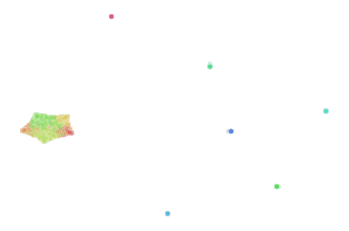

In [21]:
sim_tsne_plot = sns.scatterplot(
    x=embedding1[:,0], y=embedding1[:,1],
    hue=y,
    palette=sns.color_palette("hls", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sim_tsne_plot.set(yticks=[], xticks=[])
sns.despine(left=True, bottom=True, right=True, top=True)
print(embedding_quality(X, embedding1, y, knn=10, knn_classes=4, subsetsize=1000))

In [22]:
%time embedding2 = embedding1.optimize(n_iter=750, exaggeration=1, momentum=0.5)

CPU times: user 1min 5s, sys: 1.4 s, total: 1min 6s
Wall time: 1min 6s


(0.0858, 0.7333333333333333, 0.7254295255089013)


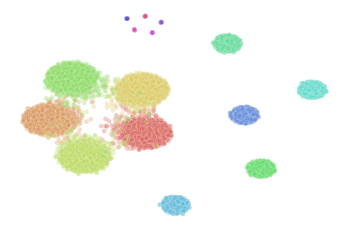

In [24]:
sim_tsne_plot = sns.scatterplot(
    x=embedding2[:,0], y=embedding2[:,1],
    hue=y,
    palette=sns.color_palette("hls", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sim_tsne_plot.set(yticks=[], xticks=[])
sns.despine(left=True, bottom=True, right=True, top=True)
print(embedding_quality(X, embedding2, y, knn=10, knn_classes=4, subsetsize=1000))

In [25]:
compute_embed_acc(X, embedding2, y,15500, knn=10, knn_classes=4, subsetsize=1000)

(0.02170967741935484, 0.8333333333333334, 0.7751240082049073)

In [138]:
%time exag_tsne = embed[4].optimize(n_iter=150, exaggeration=3, momentum=0.8)

CPU times: user 7.14 s, sys: 326 ms, total: 7.46 s
Wall time: 7.48 s


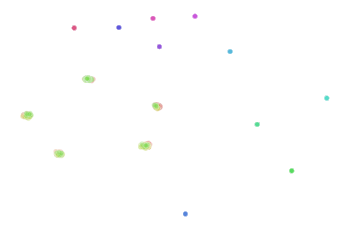

In [139]:
sim_tsne_plot_exag = sns.scatterplot(
    x=exag_tsne[:,0], y=exag_tsne[:,1],
    hue=y,
    palette=sns.color_palette("hls", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sim_tsne_plot_exag.set(yticks=[], xticks=[])
sns.despine(left=True, bottom=True, right=True, top=True)
sim_tsne_plot_exag.figure.savefig("simulation/simofftsneexag.jpg")

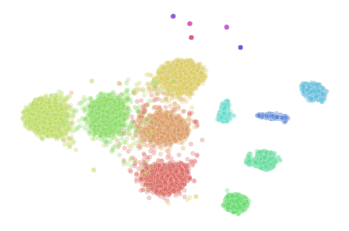

In [131]:
sim_tsne_plot = sns.scatterplot(
    x=Z3[:,0], y=Z3[:,1],
    hue=y,
    palette=sns.color_palette("hls", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sim_tsne_plot.set(yticks=[], xticks=[])
sns.despine(left=True, bottom=True, right=True, top=True)
sim_tsne_plot.figure.savefig("simulation/simofftsne_perp_lr.jpg")

In [136]:
%time exag_tsne = Z3.optimize(n_iter=150, exaggeration=3, momentum=0.8)

CPU times: user 3.99 s, sys: 37.4 ms, total: 4.02 s
Wall time: 4.03 s


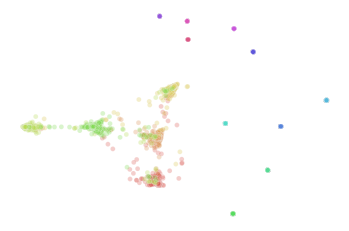

In [137]:
sim_tsne_plot = sns.scatterplot(
    x=exag_tsne[:,0], y=exag_tsne[:,1],
    hue=y,
    palette=sns.color_palette("hls", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sim_tsne_plot.set(yticks=[], xticks=[])
sns.despine(left=True, bottom=True, right=True, top=True)
sim_tsne_plot.figure.savefig("simulation/simofftsne_perp_lr_exag.jpg")

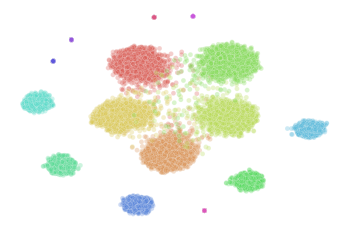

In [134]:
sim_tsne_plot = sns.scatterplot(
    x=Z4[:,0], y=Z4[:,1],
    hue=y,
    palette=sns.color_palette("hls", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sim_tsne_plot.set(yticks=[], xticks=[])
sns.despine(left=True, bottom=True, right=True, top=True)
sim_tsne_plot.figure.savefig("simulation/simoffrandom_perp_lr.jpg")

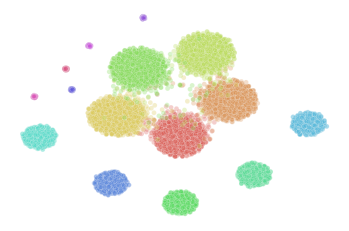

In [135]:
sim_tsne_plot_rand = sns.scatterplot(
    x=Z2[:,0], y=Z2[:,1],
    hue=y,
    palette=sns.color_palette("hls", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sim_tsne_plot_rand.set(yticks=[], xticks=[])
sns.despine(left=True, bottom=True, right=True, top=True)
sim_tsne_plot_rand.figure.savefig("simulation/sim3tsne_rand.jpg")

In [104]:
U1 = UMAP().fit_transform(X)

/Users/idewa/opt/miniconda3/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:245: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


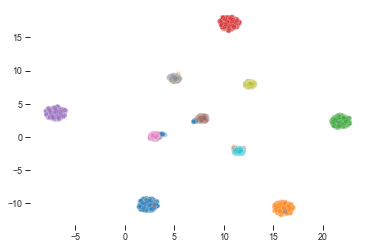

In [97]:
sim_umap_plot = sns.scatterplot(
    x=U1[:,0], y=U1[:,1],
    hue=y,
    palette=sns.color_palette("tab10", 15),
    data=X,
    legend=False,
    alpha=0.3
)
sns.despine(left=True, bottom=True, right=True, top=True)
sim_umap_plot.figure.savefig("simulation/sim1umap.jpg")